In [1]:
import pandas as pd
import datetime as dt
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager

In [2]:

# 讀取基金淨值資料
nav = pd.read_csv('yuanta_etf_clear.csv', encoding = 'big5').fillna(method = 'ffill')
nav.rename(columns = {'Unnamed: 0': 'Date'}, inplace = True)
nav['Date'] = pd.to_datetime(nav['Date'])
nav.set_index(['Date'], drop = True, inplace = True)
nav.fillna(method = 'ffill', inplace = True)
nav.head()

,元大巴西指數基金,元大商品指數期貨基金,元大標普500單日反向1倍基金,元大華夏中小基金,元大新中國基金-人民幣,元大新中國基金-新台幣,元大滬深300單日正向2倍基金,元大中國平衡基金-新台幣,元大新中國基金-美元,元大標智滬深300基金,...,元大全球不動產證券化基金-美元,元大全球地產建設入息基金-配息型,元大全球不動產證券化基金（A）-不配息型,元大全球地產建設入息基金-不配息型,元大標普500基金,元大全球不動產證券化基金（B）-配息型,元大全球農業商機基金,元大台灣50單日正向2倍基金,元大印尼指數基金,元大標普500單日正向2倍基金
Date,,,,,,,,,,,,,,,,,,,,,
2016-04-01,4.417,4.984,19.43,6.57,9.04,9.41,11.14,13.36,9.002,16.39,...,10.260,6.92,11.69,8.50,19.87,8.58,15.69,19.86,8.731,20.14
2016-04-06,4.126,4.998,19.51,6.75,9.24,9.64,11.25,13.44,9.198,16.53,...,10.202,6.88,11.65,8.45,19.93,8.55,15.42,18.99,8.739,20.13
2016-04-07,4.100,4.973,19.74,6.70,9.19,9.57,10.94,13.42,9.141,16.28,...,10.268,6.90,11.71,8.47,19.65,8.59,15.36,18.90,8.732,19.61
2016-04-08,4.362,5.111,19.69,6.69,9.14,9.53,11.03,13.41,9.097,16.26,...,10.316,6.95,11.78,8.53,19.74,8.65,15.52,19.19,8.732,19.75
2016-04-11,4.457,5.117,19.74,6.75,9.23,9.63,11.17,13.57,9.205,16.52,...,10.348,6.93,11.79,8.51,19.66,8.66,15.49,19.33,8.577,19.60


In [3]:
# 基金分類代號
info = pd.read_csv('../SITCA_定期定額/201903.csv', index_col = 0, header = 1)

info = info[['類型代號', '基金名稱']]
info = info[info['基金名稱'].isin(list(nav.columns))]
info.sort_values(['類型代號'], inplace = True)
# info = info.head()
info.head()

,類型代號,基金名稱
0,,
160,AA1,元大2001基金
275,AA1,元大經貿基金
166,AA1,元大店頭基金
165,AA1,元大巴菲特基金
274,AA1,元大高科技基金


In [4]:
# Strategy 1 定期定額
def constant(df, deposit):
    cost = 0 # 總扣款
    holding = 0 # 持有股票
    position = []
    constant = []
    current_month = df.index[0].month-1 # current month
    
    
    for i in range(len(df)):
        if current_month != df.index[i].month: # If starting new month
            current_month = df.index[i].month 
            enter = deposit/df['close'][i] # the amount of stocks to buy
            holding += enter
            cost += deposit
            
        position.append(holding * df['close'][i])
        constant.append(cost)
            
    ending = holding * df['close'][-1]
#     print('Invested     :', cost) 
#     print('Holding Stock:', round(holding, 2))    
#     print('Ending NAV   :', round(ending, 2))
#     print('Total ROI    :', round((ending/cost-1) * 100,2), '%')
    
    df['Position'] = position
    df['Deposits'] = constant
    return df, round((ending/cost-1) * 100,2) 


# Strategy 2 (when = top) 高點停利續扣
# Strategy 3 (when = bottom) 底點停利續扣
def sell(df, deposit, when):
    
    cost = 0 # 總扣款
    constant = [] 
    
    holding = 0 # 持有股票
    cash_holding = 0 # 出場所得到的現金
    position = []
    cash_position = []
    
    buy_date = []
    buy_price = []
    sell_date = []
    sell_price = []
    event = []
    
    status = 0
    current_month = df.index[0].month-1 # current month
    df['20 MA']  = df['close'].rolling(20).mean()
    df['50 MA']  = df['close'].rolling(50).mean()
    
    past_market = 'bull'
    for i in range(len(df)):
        
        if when != 'SMA':
            if current_month != df.index[i].month: # If starting new month
                buy_date.append(list(df.index)[i])
                buy_price.append(df['close'][i])
                current_month = df.index[i].month 
                enter = deposit/df['close'][i] # 購買股票張數 
                holding += enter
                cost += deposit
            
        market = df['20 MA'][i] - df['50 MA'][i]
        market = 'bull' if market > 0 else 'bear'
        
        if when == 'bottom' and past_market == 'bear' and market == 'bull' and i >=50:
#             print('Sell', list(df.index)[i])
            sell_date.append(list(df.index)[i])
            sell_price.append(df['close'][i])
            cash_holding += holding * df['close'][i]
            holding = 0
            
        if when == 'top' and past_market == 'bull' and market == 'bear' and i >=50:
#             print('Sell', list(df.index)[i])
            sell_date.append(list(df.index)[i])
            sell_price.append(df['close'][i])
            cash_holding += holding * df['close'][i]
            holding = 0
        
        if when == 'SMA' and i ==0:
            buy_date.append(list(df.index)[i])
            buy_price.append(df['close'][i])
            enter = deposit/df['close'][i]
            holding += enter
            cost += deposit
            
        if when == 'SMA' and past_market == 'bear' and market == 'bull' and i >=50:
#             print('Sell', list(df.index)[i])
            buy_date.append(list(df.index)[i])
            buy_price.append(df['close'][i])
            enter = deposit/df['close'][i]
            holding += enter
            cost += deposit
            
        if when == 'SMA' and past_market == 'bull' and market == 'bear' and i >=50:
#             print('Sell', list(df.index)[i])
            sell_date.append(list(df.index)[i])
            sell_price.append(df['close'][i])
            cash_holding += holding * df['close'][i]
            holding = 0
            
            
        past_market = market
        
            
        position.append(holding * df['close'][i])
        cash_position.append(cash_holding)
        constant.append(cost)
            
    ending = holding * df['close'][-1] + cash_holding
#     print()
#     print('Invested     :', cost)
#     print('Holding Stock:', round(holding, 2))
#     print('Stock Price  :', round(df['close'][-1], 2))
#     print('Cash Holding :', round(cash_holding, 2))
#     print('Ending NAV   :', round(ending, 2))
#     print('Total ROI    :', round((ending/cost-1) * 100,2), '%')
    
    df['Stock Position'] = position
    df['Cash Position'] = cash_position
    df['Deposits'] = constant
    df['Total'] = [x+y for x, y in zip(position, cash_position)]
    
    action_sell = pd.DataFrame({'Date': sell_date, 'Price':sell_price})
    action_sell.set_index(['Date'], drop = True, inplace = True)

    action_buy = pd.DataFrame({'Date': buy_date, 'Price':buy_price})
    action_buy.set_index(['Date'], drop = True, inplace = True)
    
    return df, action_sell, action_buy, round((ending/cost-1) * 100,2)



# def graph_simple(title, graph, graph2 = None):

#     plt.style.use('seaborn')
#     font = font_manager.FontProperties(fname='msjh.ttc', weight='bold', style='normal', size=18)
#     fig = plt.figure(1, (18,10))
#     ax1 = fig.add_subplot(1,1,1)
#     ax1.plot(graph)
#     ax1.legend(graph.columns)
#     plt.title(fund, fontproperties = font)
#     plt.show()

def graph(title, graph, graph_buy = None, graph_sell=None):
    plt.rcParams['figure.dpi']= 100
    plt.style.use('seaborn')
    font = font_manager.FontProperties(fname='msjh.ttc', weight='bold', style='normal', size=18)
    fig = plt.figure(1, (18,8))
    ax1 = fig.add_subplot(1,1,1)
    ax1.plot(graph)
    ax1.legend(['Price', '20MA', '50MA'])
    
    if graph_buy is not None:
        ax1.plot(graph_buy['Price'].index, graph_buy['Price'], '^', color = 'limegreen',  markersize = 12)
        
    if graph_sell is not None:
        ax1.plot(graph_sell['Price'].index, graph_sell['Price'], 'rv', markersize = 12)
        
    plt.title(title, fontproperties = font)
    
    if 'SMA' in title:
        plt.savefig('results/SMA/'+title + '.png')
    if '定期定額' in title:
        plt.savefig('results/定期定額/'+title + '.png')   
    if '低點停利續扣' in title:
        plt.savefig('results/低點停利續扣/'+title + '.png')  
    if '高點停利續扣' in title:
        plt.savefig('results/高點停利續扣/'+title + '.png')  
        
    plt.show()
    
dfs = []
returns = [] 
for fund in info['基金名稱']:
    returns.append((nav[fund][-1]/nav[fund][0]-1)*100)
info['期初買入'] = returns
simple = pd.DataFrame(info.groupby(['類型代號'])['期初買入'].mean())
dfs.append(simple)
simple

,期初買入
類型代號,
AA1,17.535638
AA2,9.911728
AB2,10.829833
AC21,-9.284434
AD1,1.122840
AD2,3.358053
AE21,7.958543
AE23,2.947368
AG,10.725838


/usr/local/lib/python3.7/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


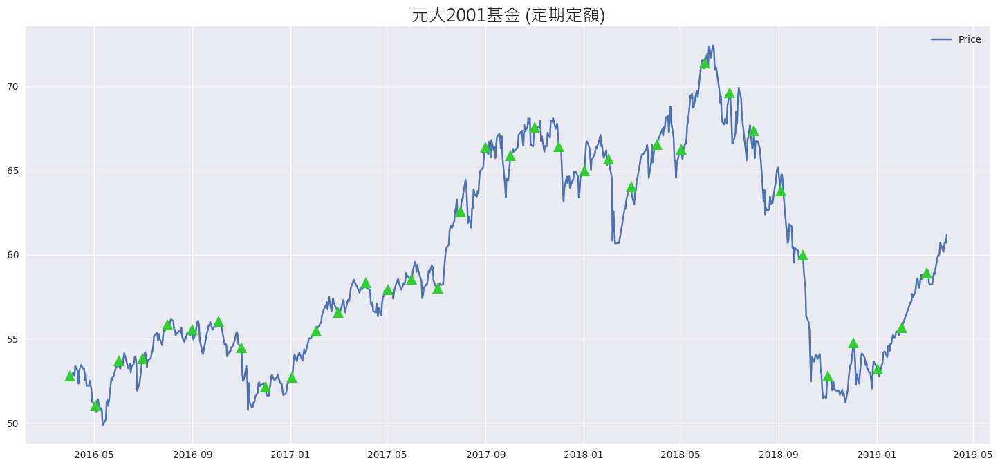

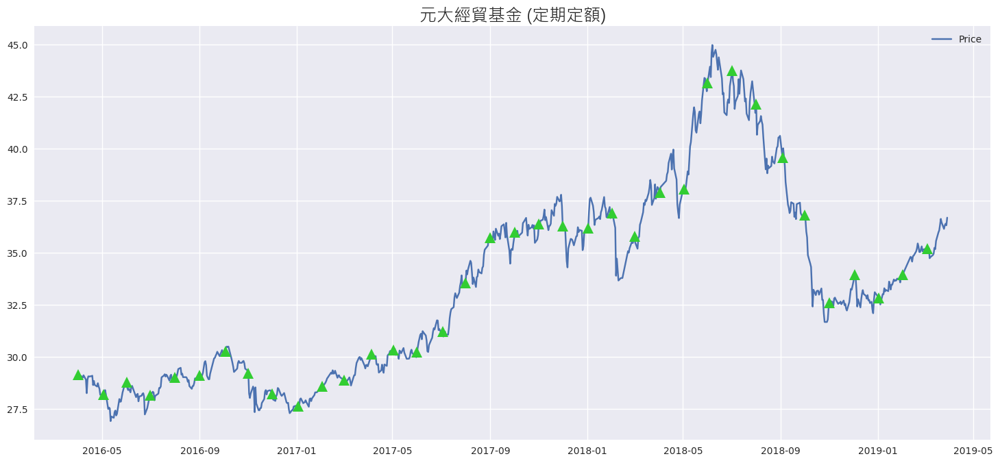

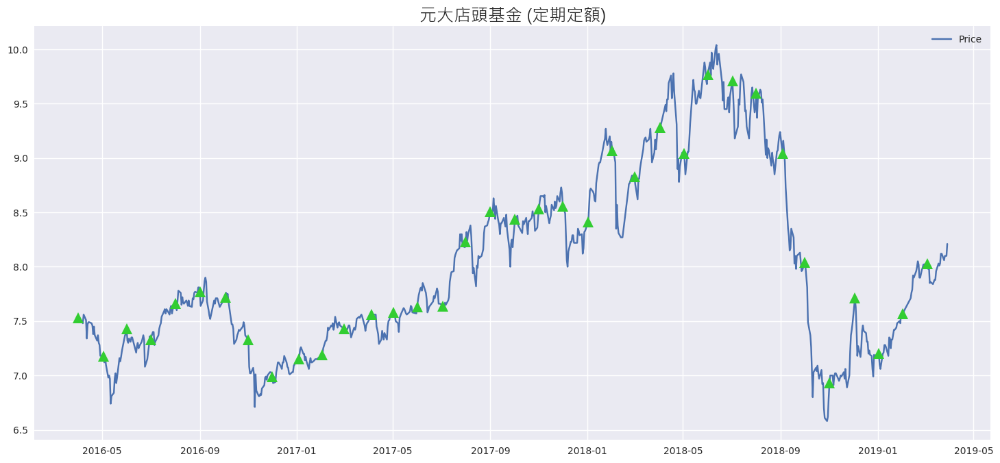

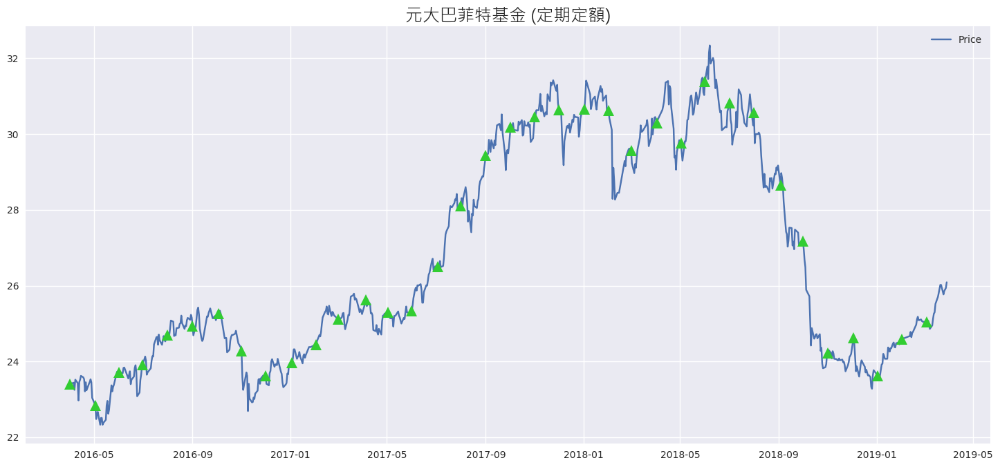

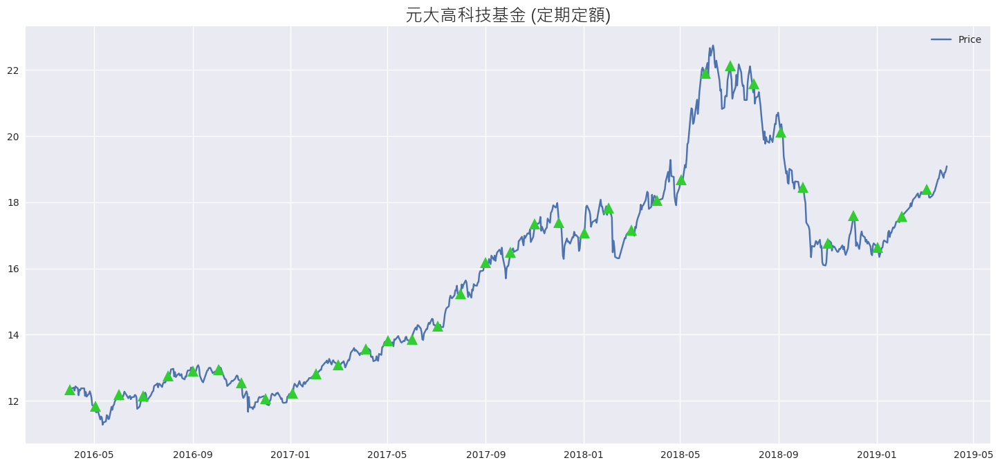

...

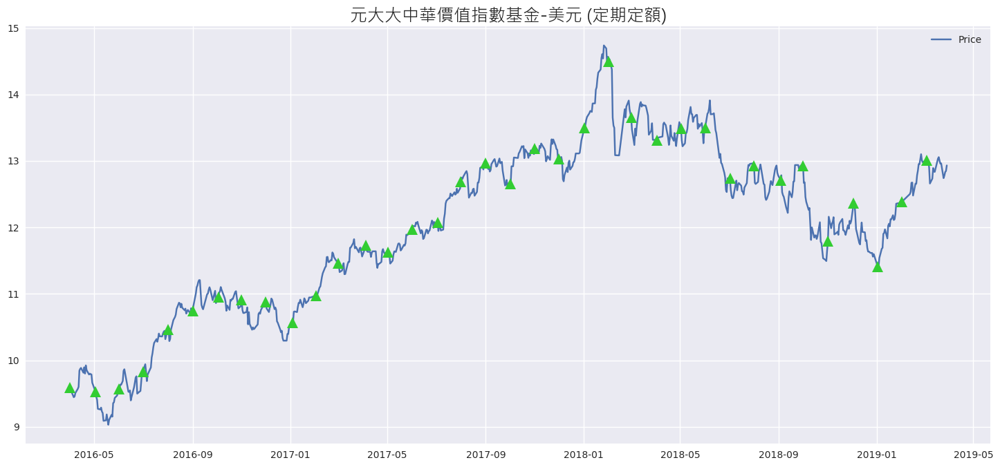

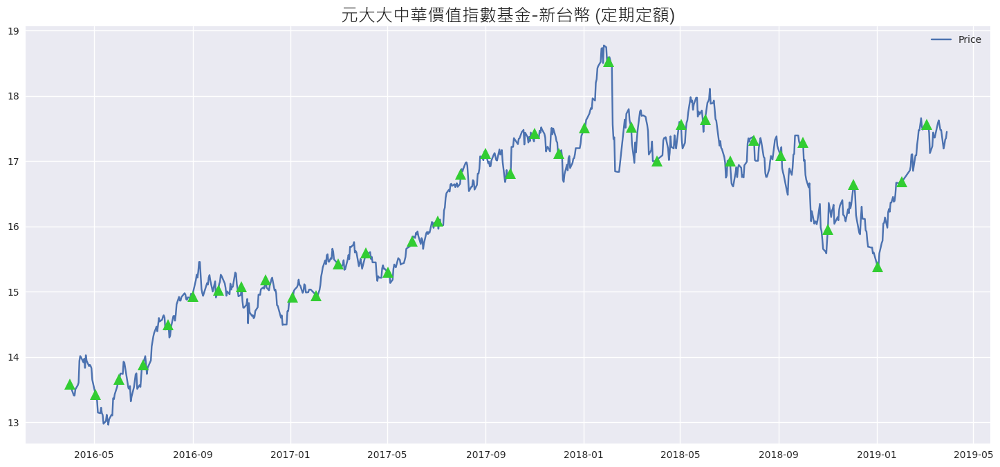

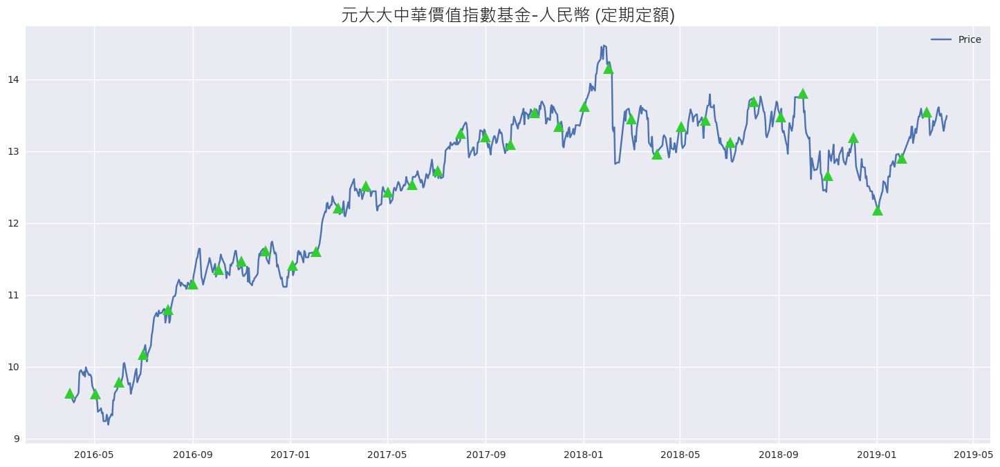

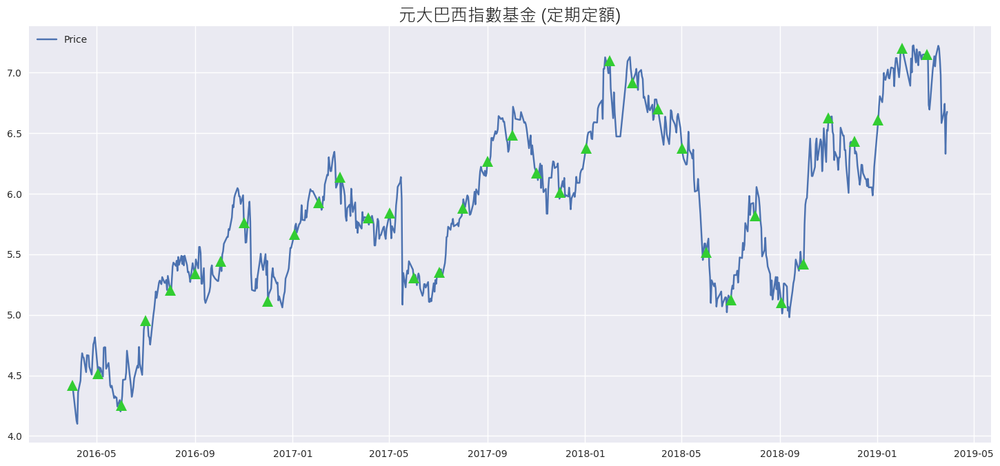

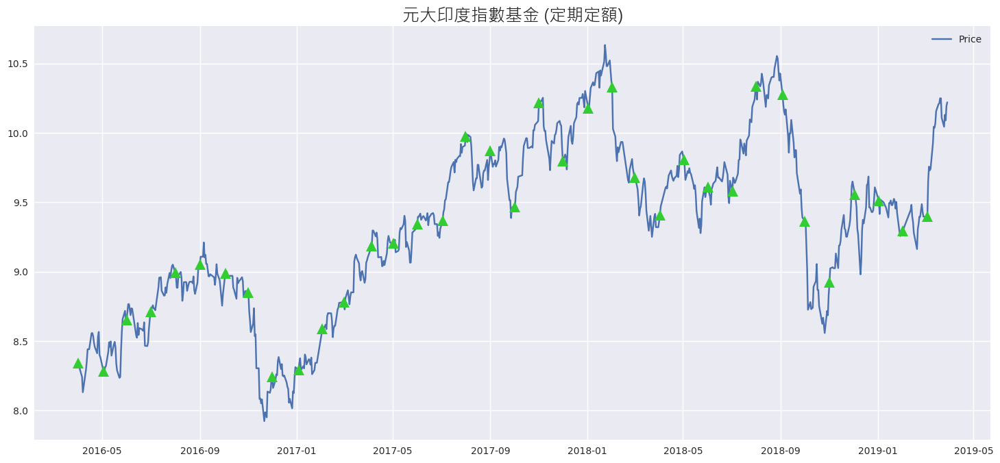

,定期定額
類型代號,
AA1,4.450000
AA2,0.938667
AB2,3.675000
AC21,-4.312000
AD1,0.636667
AD2,3.770000
AE21,3.010000
AE23,2.170000
AG,6.780000


In [5]:
returns = [] 
for fund, label in zip(info['基金名稱'], info['類型代號']):
#     print('\n', fund, label)
#     df = nav[fund]
#     df = pd.DataFrame(df)
#     df.rename(columns = {fund:'close'}, inplace = True)
    
#     df, ROI = constant(df, 100)
#     returns.append(ROI)

#     graph_simple(fund + ' (定期定額)', df[['Position','Deposits']])
    
    df = nav[fund]
    df = pd.DataFrame(df)
    df.rename(columns = {fund:'close'}, inplace = True)
    df, action_sell, action_buy, ROI = sell(df, 100, 'never') # Call function
    returns.append(ROI)
    
    graph2 = df[['close']]
    graph(fund + ' (定期定額)', graph2, action_buy, action_sell)
    
info['定期定額'] = returns

constant = pd.DataFrame(info.groupby(['類型代號'])['定期定額'].mean())
dfs.append(constant)
constant

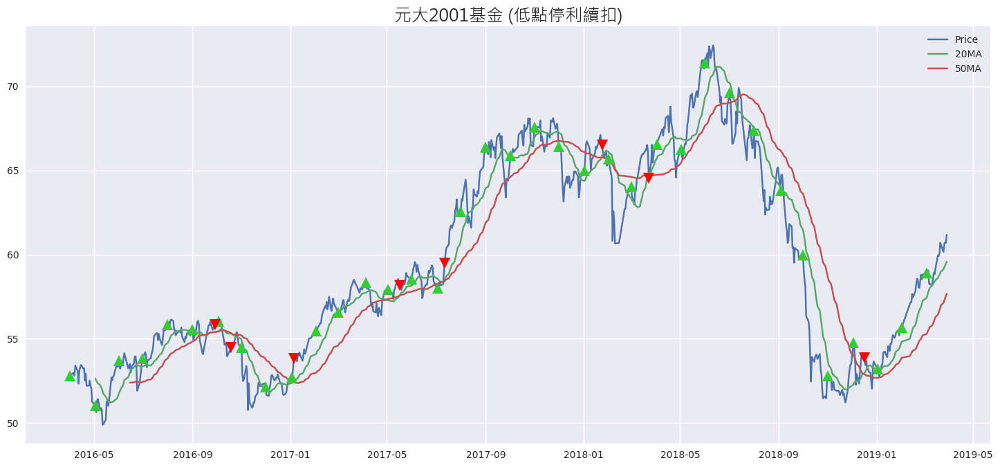

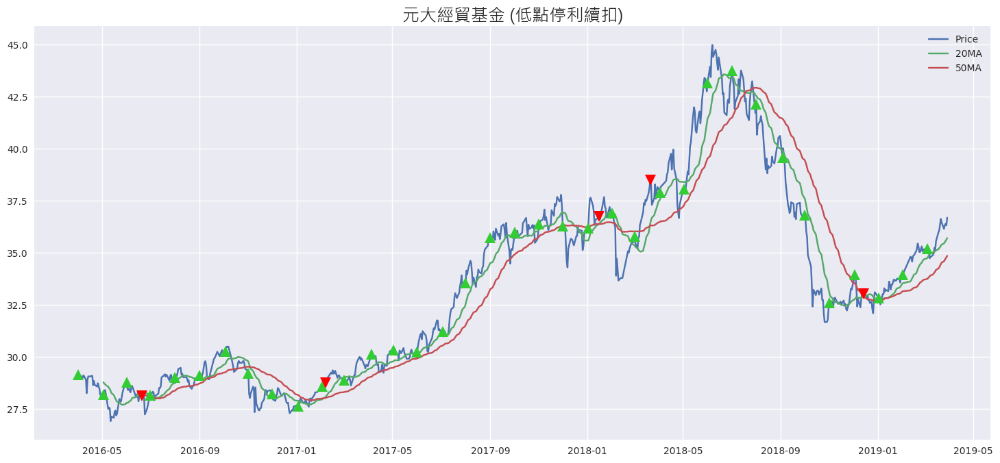

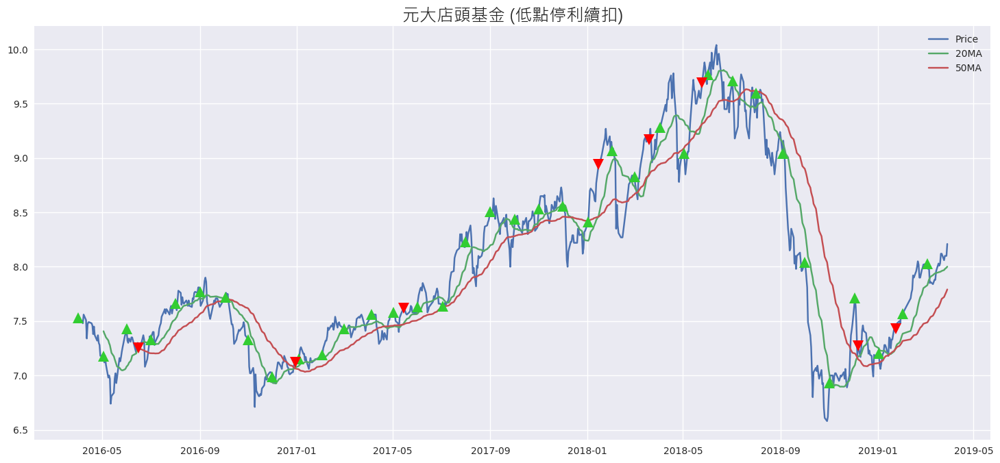

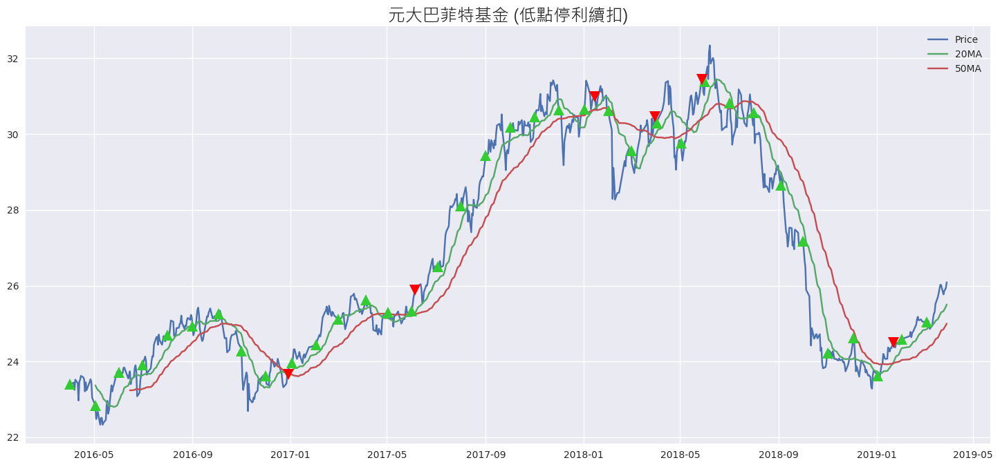

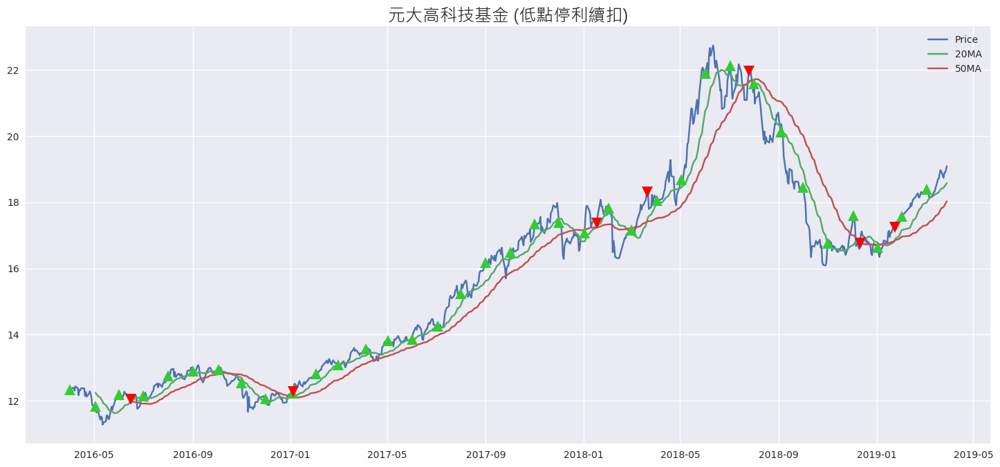

...

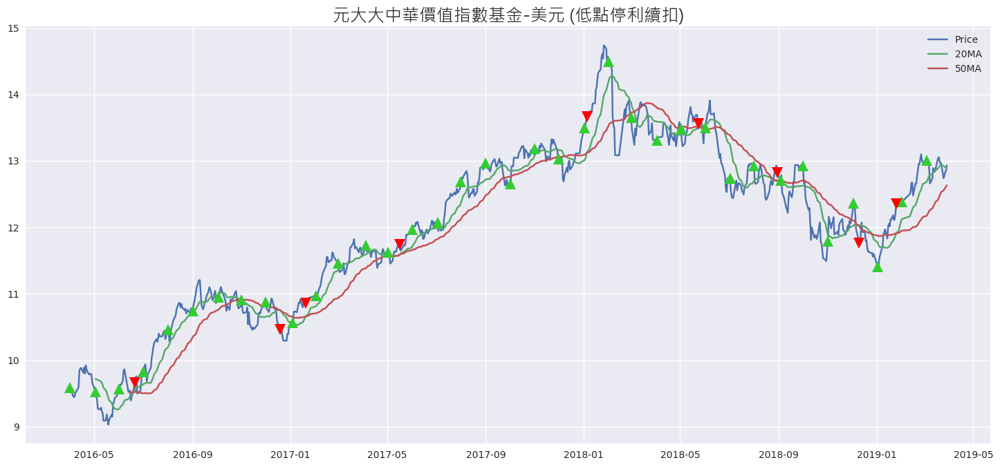

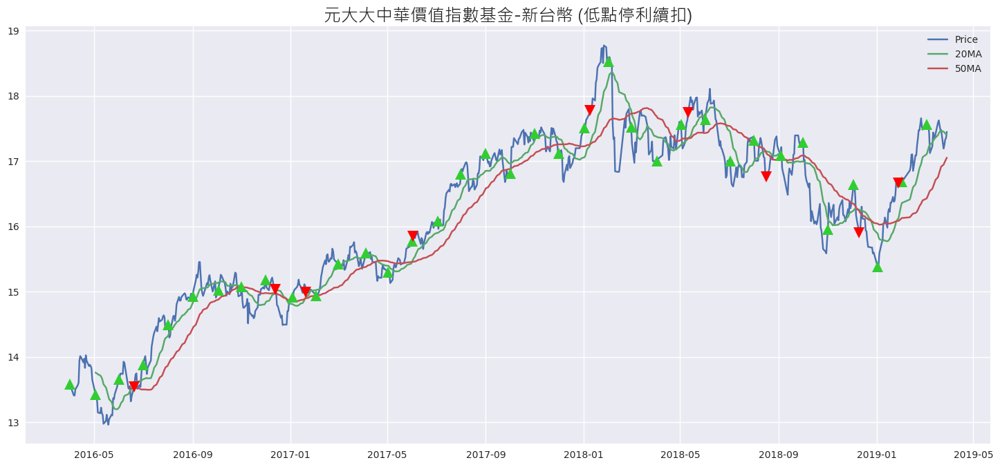

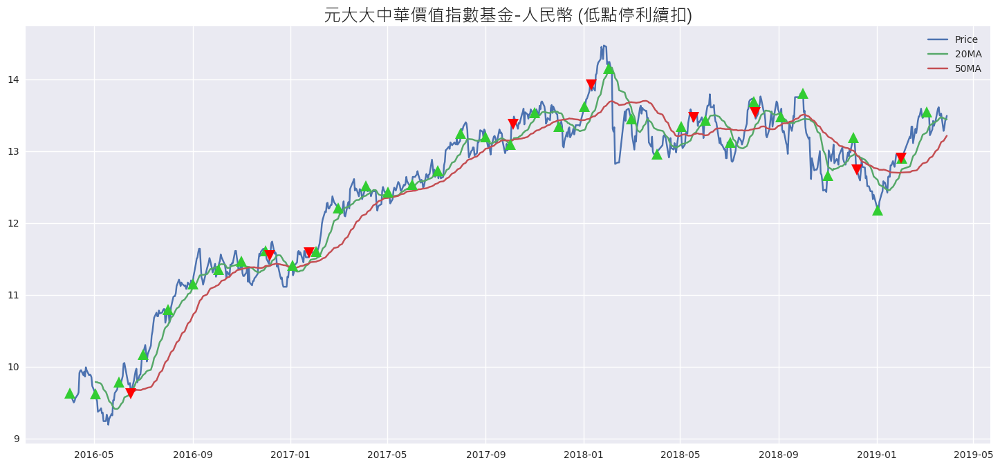

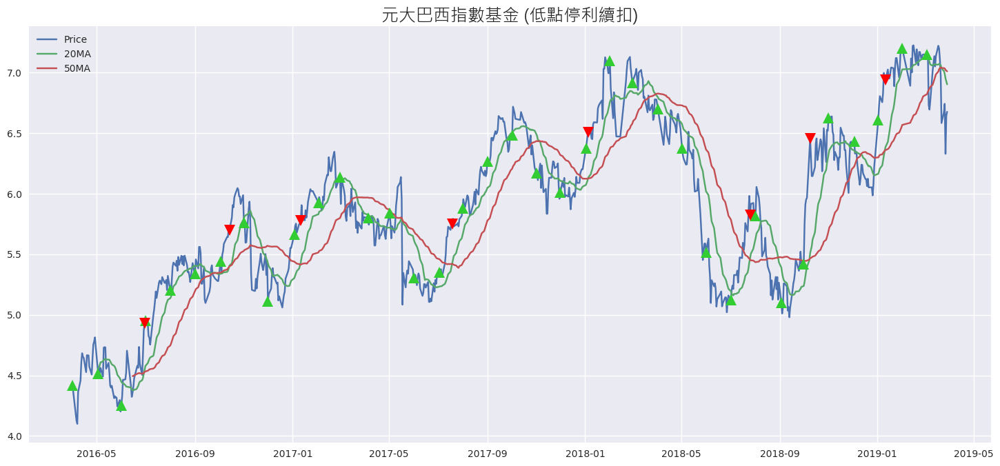

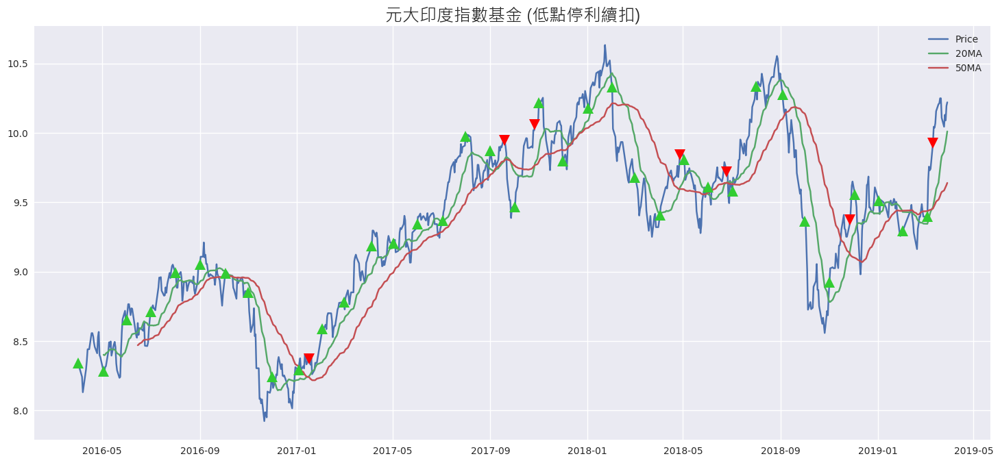

,低點停利續扣
類型代號,
AA1,-0.165556
AA2,0.530667
AB2,0.625000
AC21,-1.048000
AD1,0.636667
AD2,1.995000
AE21,1.710000
AE23,0.850000
AG,1.215000


In [6]:
returns = []
for fund, label in zip(info['基金名稱'], info['類型代號']):
#     print('\n', fund, label)
    df = nav[fund]
    df = pd.DataFrame(df)
    df.rename(columns = {fund:'close'}, inplace = True)
    df, action_sell, action_buy, ROI = sell(df, 100, 'bottom') # Call function
    returns.append(ROI)
    
    graph2 = df[['close', '20 MA', '50 MA']]
    graph(fund + ' (低點停利續扣)', graph2, action_buy, action_sell)

info['低點停利續扣'] = returns

low = pd.DataFrame(info.groupby(['類型代號'])['低點停利續扣'].mean())
dfs.append(low)
low

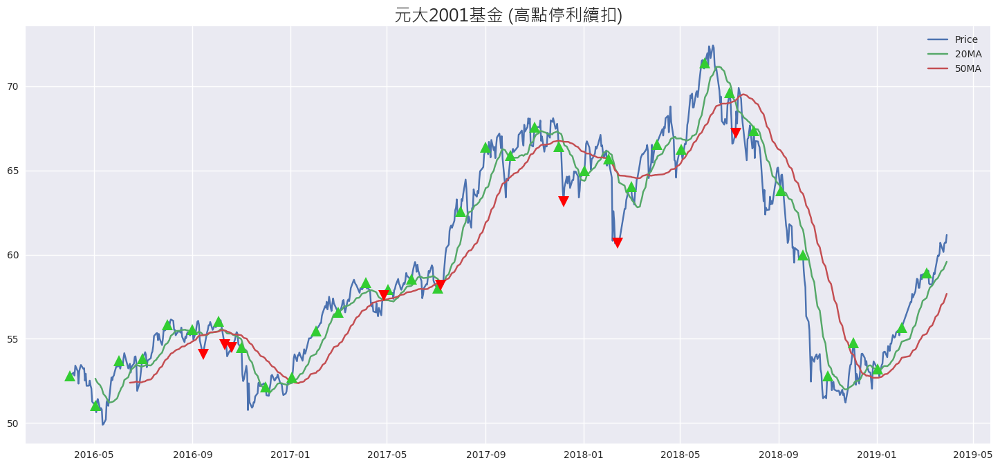

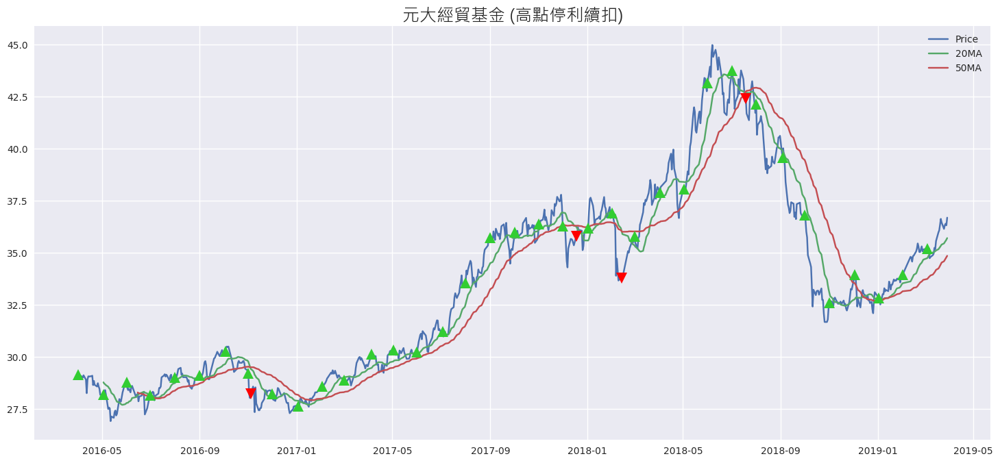

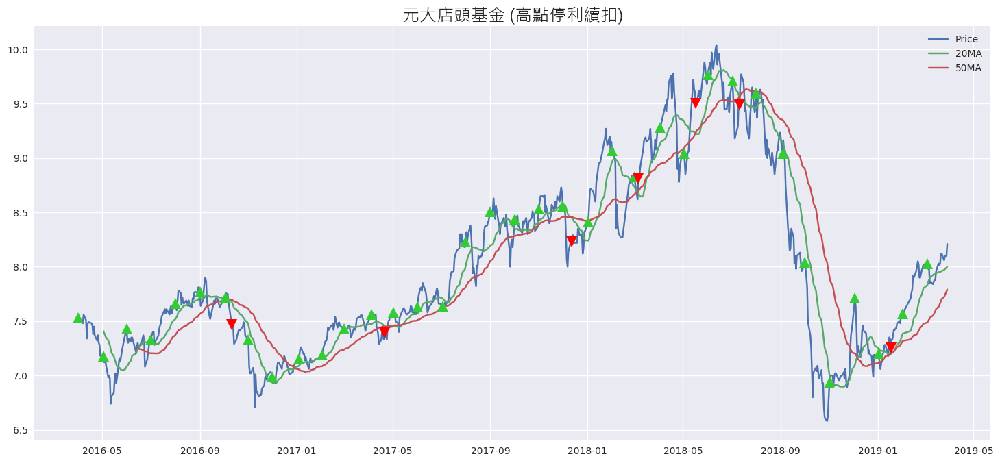

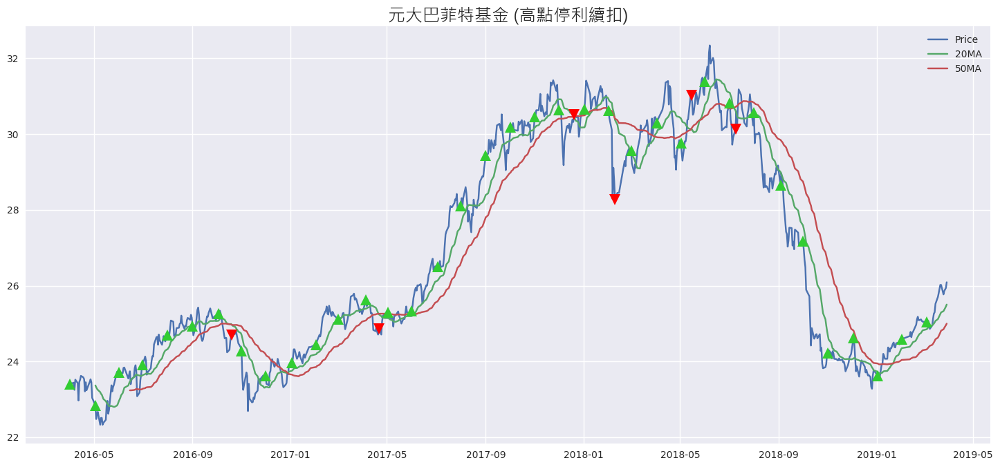

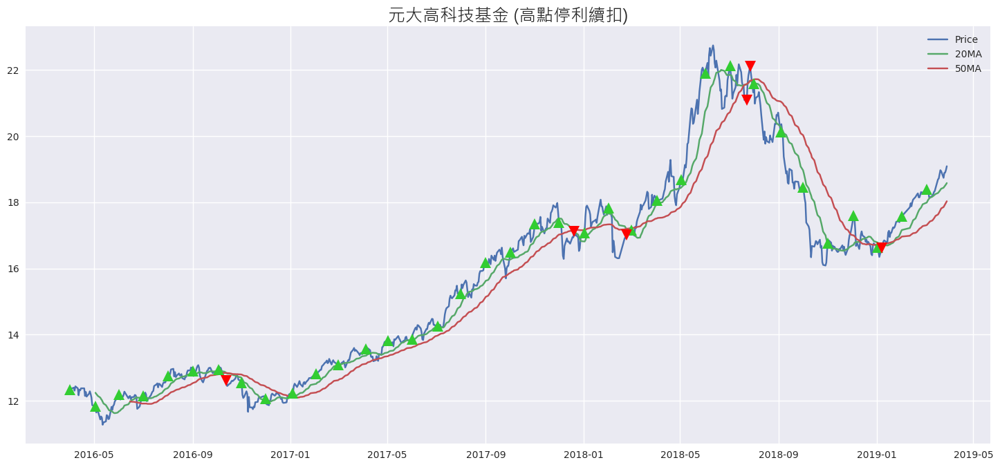

...

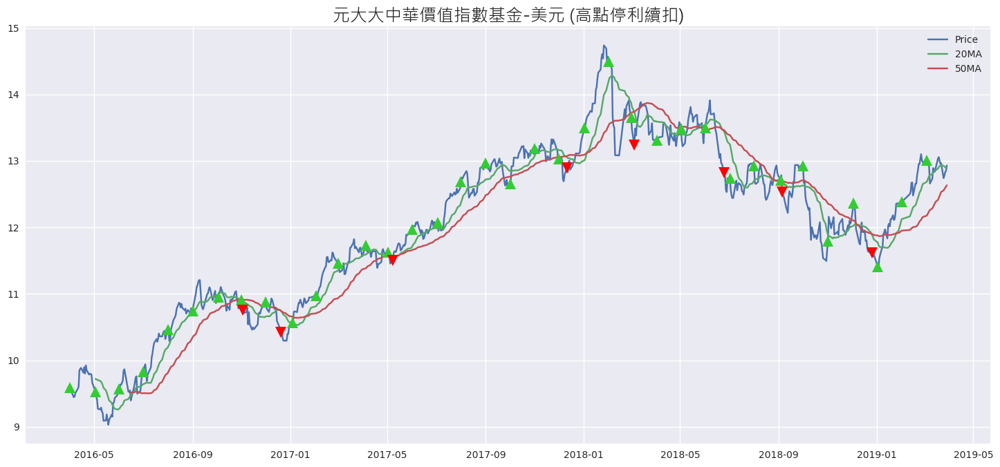

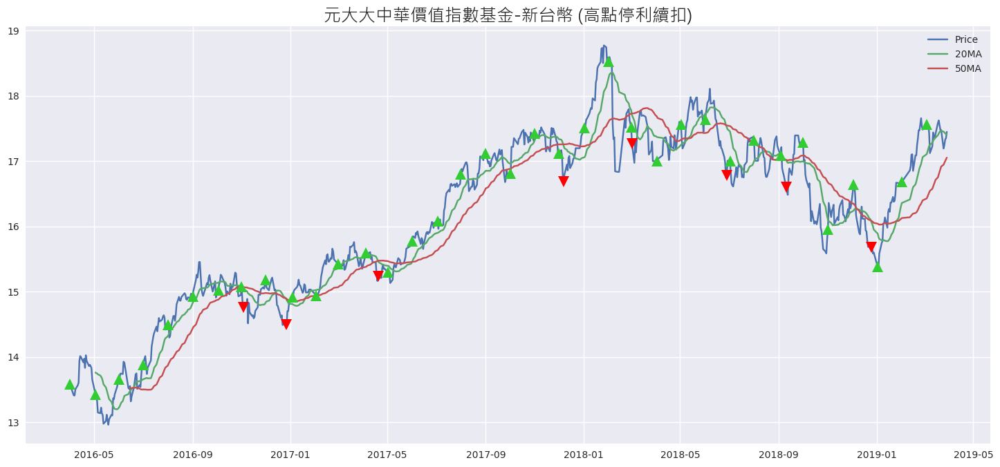

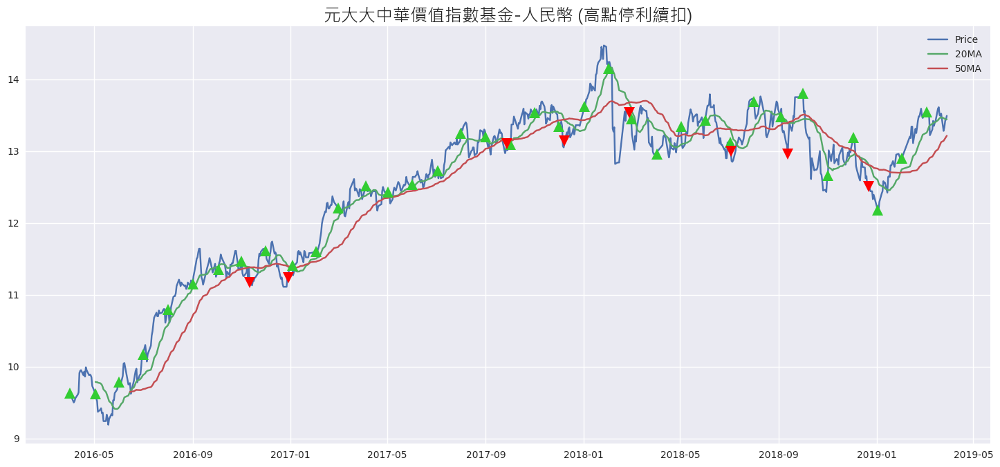

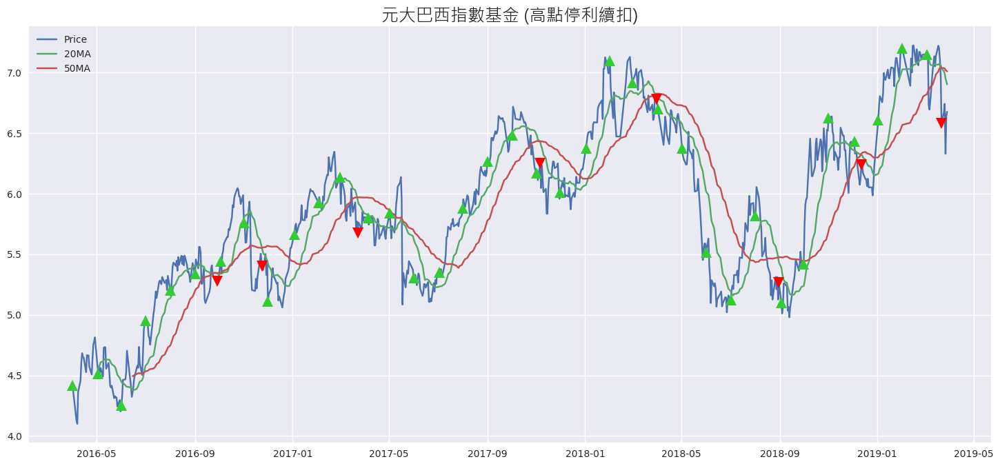

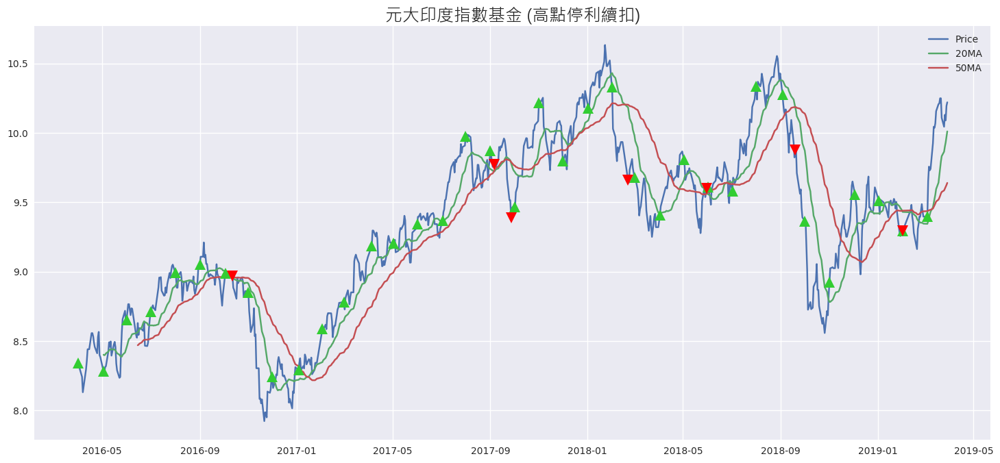

,高點停利續扣
類型代號,
AA1,2.628889
AA2,2.248000
AB2,0.035000
AC21,0.112000
AD1,0.636667
AD2,2.292500
AE21,2.180000
AE23,0.800000
AG,0.327500


In [7]:
returns = []
for fund, label in zip(info['基金名稱'], info['類型代號']):
    df = nav[fund]
    df = pd.DataFrame(df)
    df.rename(columns = {fund:'close'}, inplace = True)
    df, action_sell, action_buy, ROI = sell(df, 100, 'top') # Call function
    returns.append(ROI)
    
    graph2 = df[['close', '20 MA', '50 MA']]
    graph(fund + ' (高點停利續扣)' , graph2, action_buy, action_sell)
    
info['高點停利續扣'] = returns

high = pd.DataFrame(info.groupby(['類型代號'])['高點停利續扣'].mean())
dfs.append(high)
high

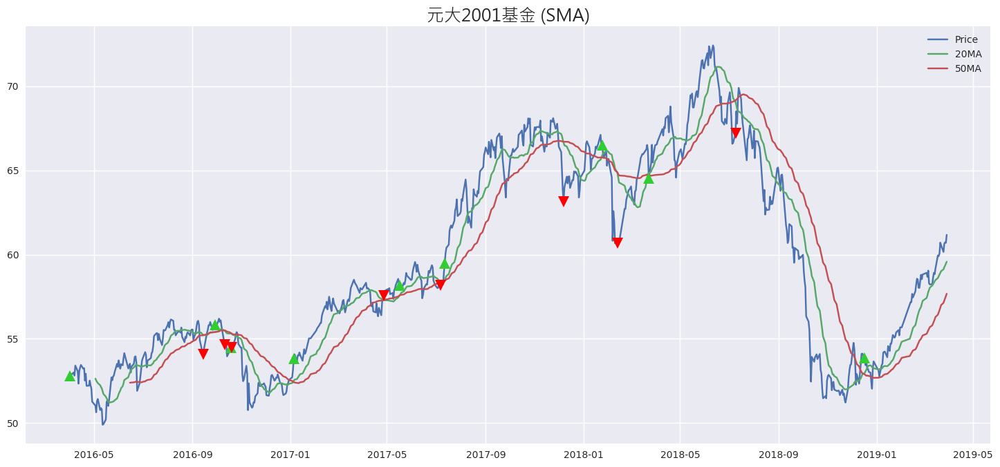

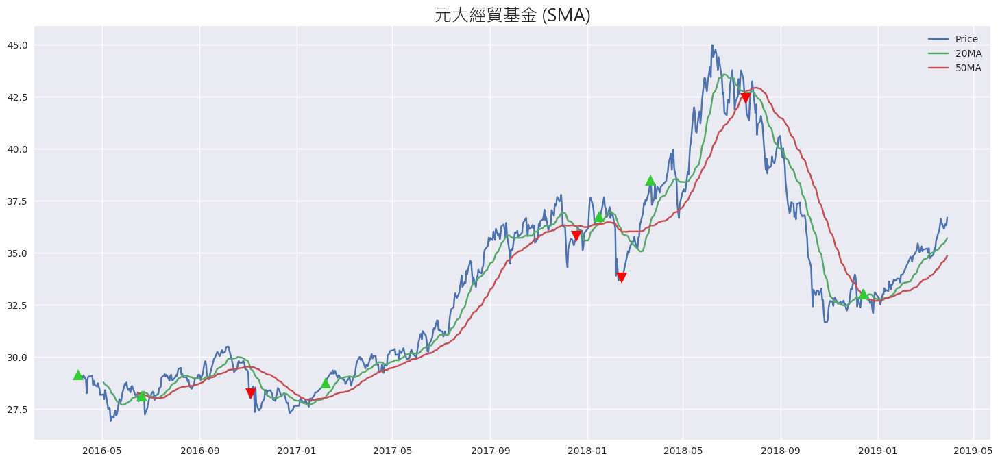

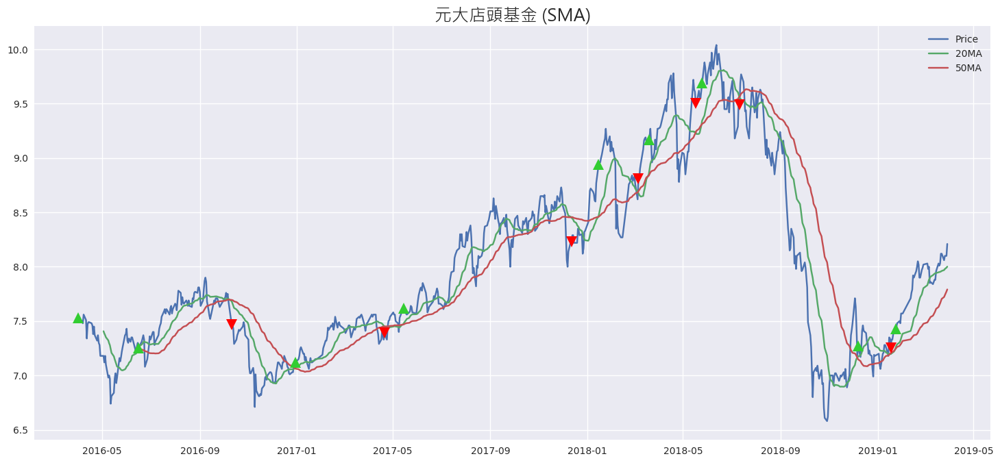

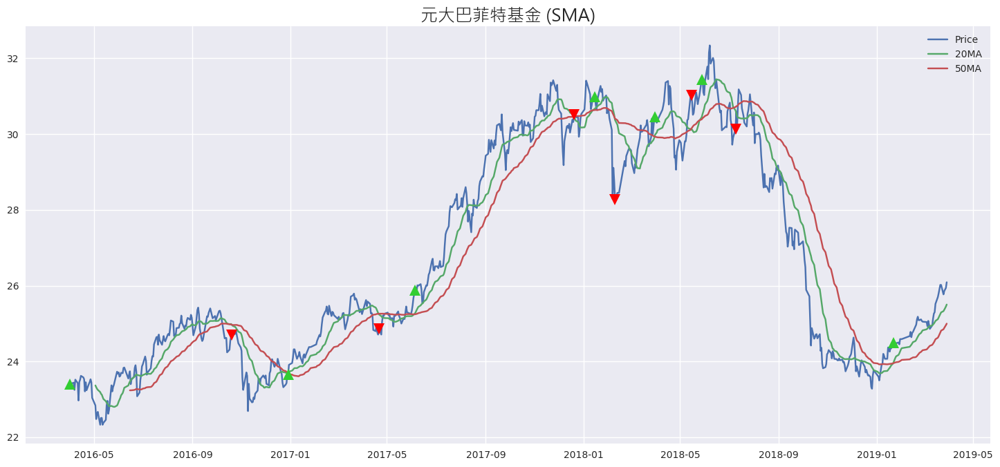

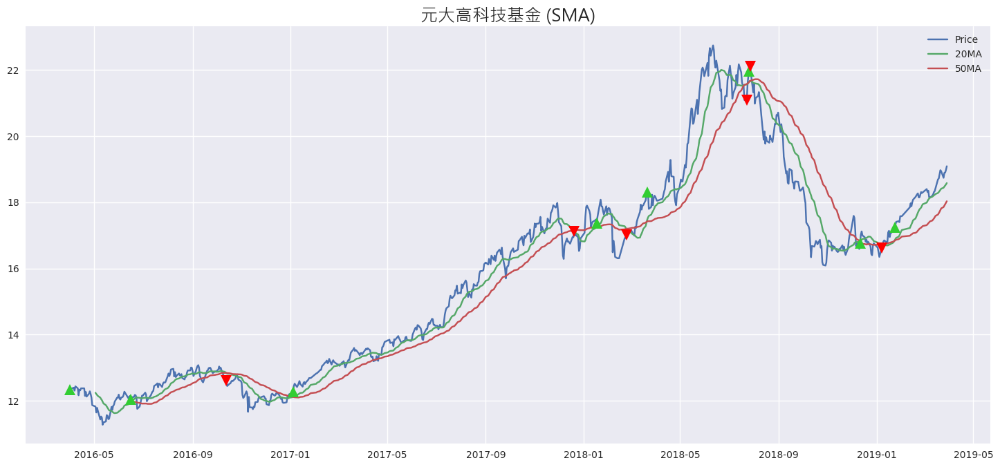

...

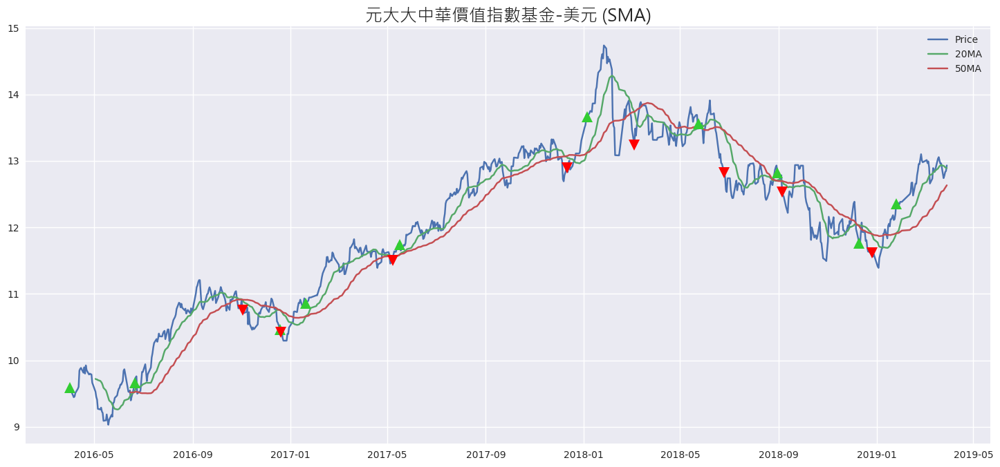

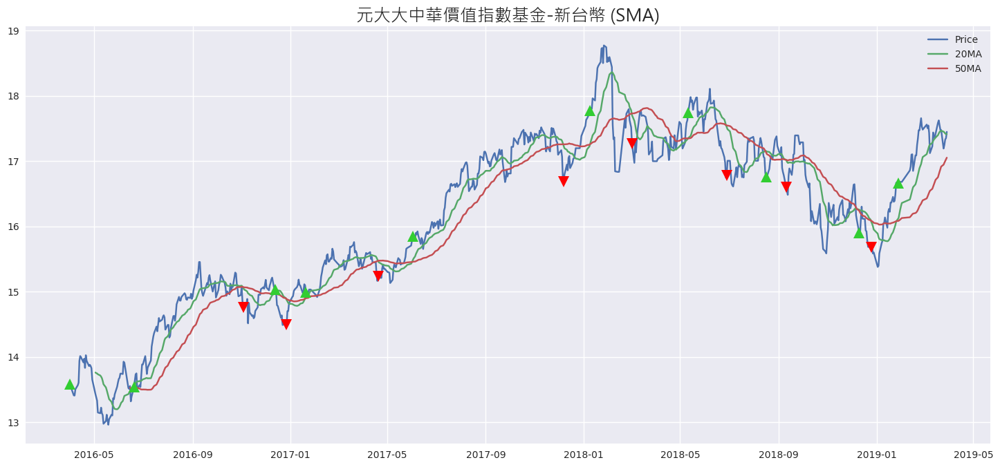

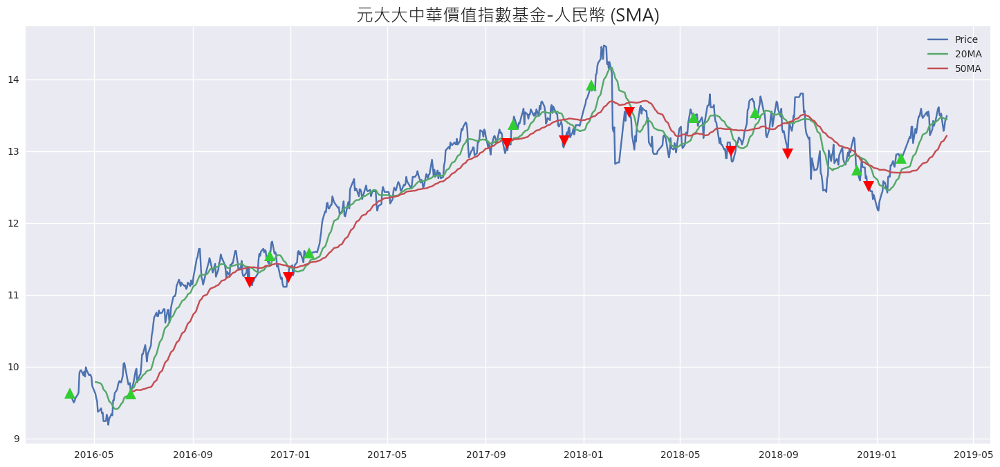

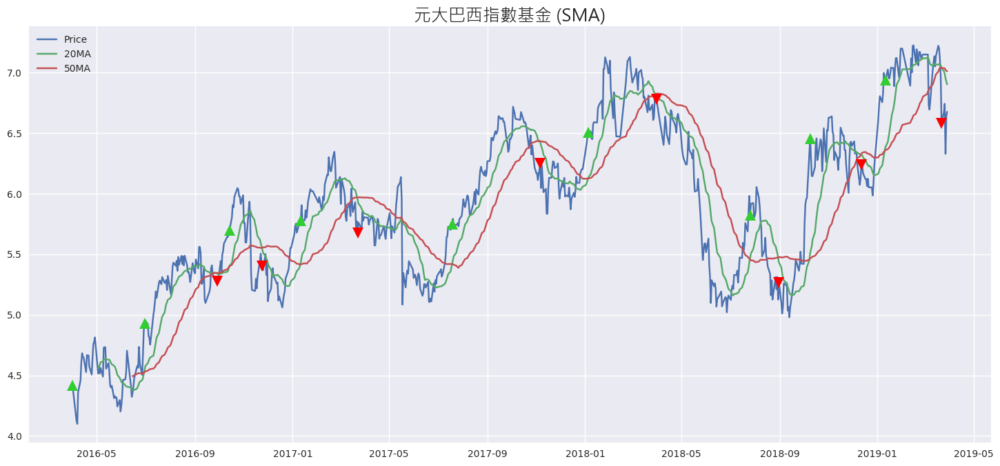

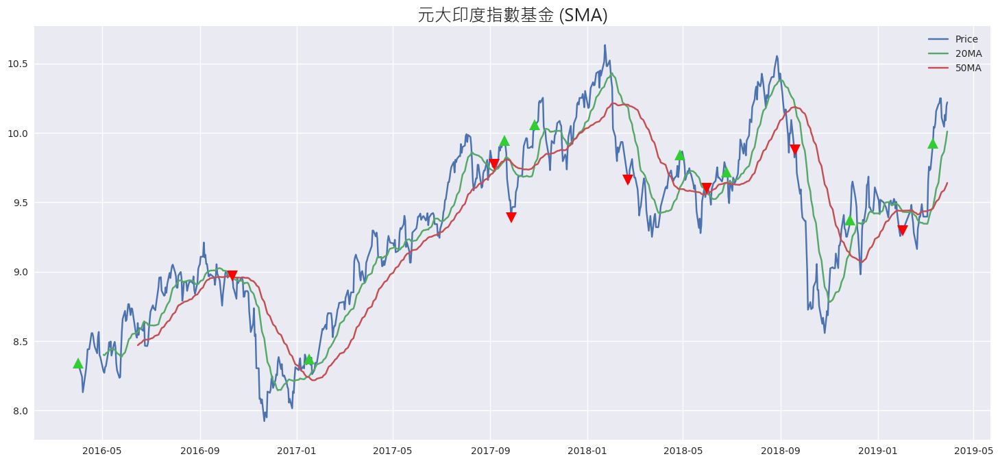

,SMA
類型代號,
AA1,4.297778
AA2,2.921333
AB2,1.190000
AC21,0.052000
AD1,1.126667
AD2,3.637500
AE21,1.190000
AE23,0.420000
AG,-0.302500


In [8]:
returns = []
for fund, label in zip(info['基金名稱'], info['類型代號']):
    df = nav[fund]
    df = pd.DataFrame(df)
    df.rename(columns = {fund:'close'}, inplace = True)
    df, action_sell, action_buy, ROI = sell(df, 100, 'SMA') # Call function
    returns.append(ROI)
    
    graph2 = df[['close', '20 MA', '50 MA']]
    graph(fund + ' (SMA)', graph2, action_buy, action_sell)
    
info['SMA'] = returns

high = pd.DataFrame(info.groupby(['類型代號'])['SMA'].mean())
dfs.append(high)
high

In [9]:
pd.concat(dfs, axis = 1).to_csv('results/result_by_category.csv')

#### 整體而言定期定額為最佳策略 
#### 高點停利續扣策略雖然報酬較低但相對穩定 適合匯率和區域性風險大的跨國基金 (Ex. AC21 元大新興印尼機會債券基金)

In [10]:
# AA1	國內投資股票型	Domestic Equity Fund
# AA2	跨國投資股票型	International Equity Fund
# AB1	國內投資平衡型	Domestic Balanced Fund
# AB2	跨國投資平衡型	International Balanced Fund
# AC12	國內投資固定收益一般債券型	Domestic Fixed-income Fund
# AC21	跨國投資固定收益一般債券型	International Fixed-income Fund
# AC22	金融資產證券化型	Financial Asset Securitization Fund
# AC23	高收益債券型	High Yield Bond Fund
# AD1	國內投資貨幣市場基金	Domestic Money Market Fund
# AD2	跨國投資貨幣市場基金	International Money Market Fund
# AE1	國內投資組合型	Domestic Fund of Funds
# AE21	跨國投資組合型_股票型	International Fund of Funds - Equity Fund
# AE22	跨國投資組合型_債券型	International Fund of Funds - Bond Fund
# AE23	跨國投資組合型_平衡型	International Fund of Funds - Balanced Fund
# AE24	跨國投資組合型_其他	International Fund of Funds - Others
# AF	保本型  	Principal Guaranteed Fund
# AG	不動產證券化型 	REITs Fund
# AH1	國內投資指數股票型	Domestic Exchange Traded Fund
# AH2	跨國投資指數股票型	International Exchange Traded Fund
# AI1	國內投資指數型	Domestic Index Fund
# AI2	跨國投資指數型	International Index Fund
# AJ1	國內投資多重資產型	Domestic Multi-asset Fund
# AJ2	跨國投資多重資產型	International Multi-asset Fund
# AC11	類貨幣市場型	Domestic Bond Fund - Quasi Money Market Fund

# http://www.selaw.com.tw/LawContent.aspx?LawID=G0101140

In [11]:
# info[info['類型代號'] =='AC21'].reset_index(drop=True)
info.reset_index(drop=True).to_csv('results/individual_results.csv')

In [12]:
# https://www.moneydj.com/funddj/yp999999.djhtm

In [13]:
# returns = []
# for fund, label in zip(info['基金名稱'], info['類型代號']):
# #     print('\n', fund, label)
#     df = nav[fund]
#     df = pd.DataFrame(df)
#     df.rename(columns = {fund:'close'}, inplace = True)
    
#     df, ROI = constant(df, 100)
#     graph_simple(fund, df[['Position','Deposits']])


#     df, action, ROI = sell(df, 100, 'bottom') # Call function
#     graph(fund, df[['Stock Position', 'Cash Position', 'Deposits', 'Total']])
    
#     returns.append(ROI)
#     graph2 = pd.concat([df[['close', '20 MA', '50 MA']], action], sort = True)
#     graph2 = df[['close', '20 MA', '50 MA']]
#     graph(fund, graph2, action)

# info['ROI'] = returns
# pd.DataFrame(info.groupby(['類型代號'])['ROI'].mean())